<a href="https://colab.research.google.com/github/jabigailjoseph/Florida-Pine-Rescue/blob/main/Florida_Pine_Rescue.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# At times, Australian pines will be refered to as casuarinas/casuarina trees for simplicity, and vice versa

In [ ]:
# Imports

!pip install wandb
!apt-get install poppler-utils
!pip install pdf2image
import requests
from pdf2image import convert_from_path
import matplotlib.pyplot as plt
import numpy as np
import torch
import requests
from torchvision import *
import torchvision.transforms as transforms
from torchvision.models import *
import wandb as wb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 252.8/252.8 kB 16.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.9 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 15 not upgraded.
Need to get 186 kB of archives.
After this operation, 696 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.3 [186 kB]
Fetched 186 kB in 0s (412 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 120899 files and directories currently installed.)
Preparing to unpack .../poppler-utils_22.02.0-2ubuntu0.3_amd64.deb ...
Unpacking

In [ ]:
'''

# loading pretrained AlexNet
labels = {int(key):value for (key, value) in requests.get('https://s3.amazonaws.com/mlpipes/pytorch-quick-start/labels.json').json().items()}
model = alexnet(pretrained=True).to(device)
model.eval();

'''

"\n\n# loading pretrained AlexNet \nlabels = {int(key):value for (key, value) in requests.get('https://s3.amazonaws.com/mlpipes/pytorch-quick-start/labels.json').json().items()}\nmodel = alexnet(pretrained=True).to(device)\nmodel.eval();\n\n"

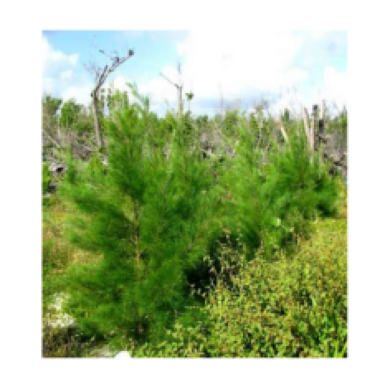

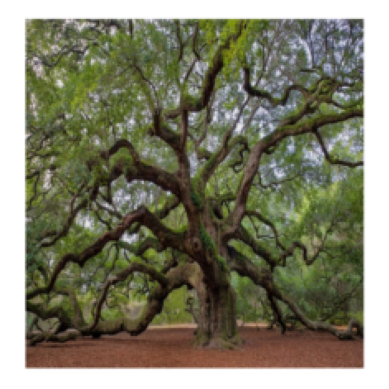

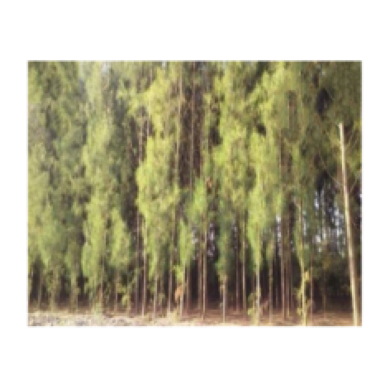

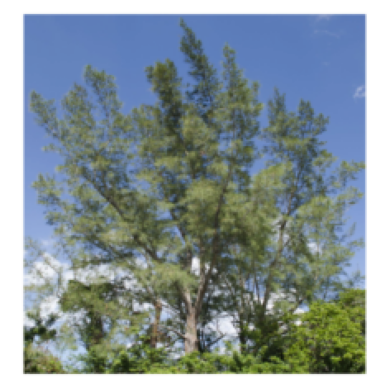

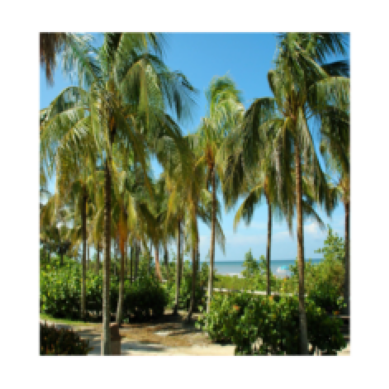

...

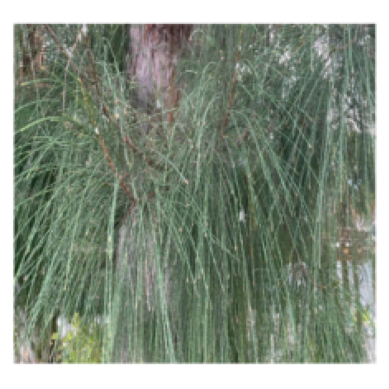

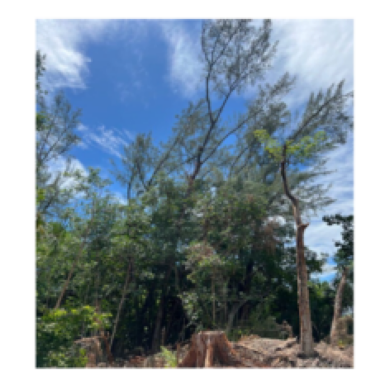

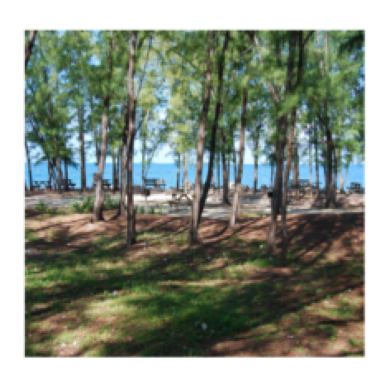

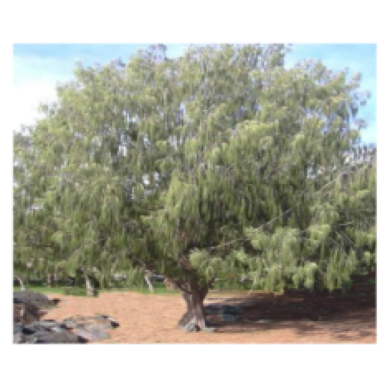

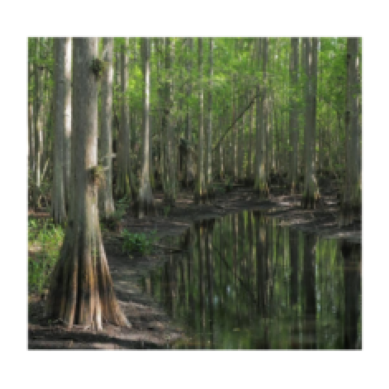

In [ ]:
# Loading images from FPR dataset

# Install pdf2image
!pip install pdf2image

# Imports
import os
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import torch
from pdf2image import convert_from_path

# Convert PDF to images and save them
pdf_path = '/content/FPR_dataset.pdf'  # Replace with the path to your PDF file
output_image_dir = '/content/pdf_images/'
os.makedirs(output_image_dir, exist_ok=True)

images_from_pdf = convert_from_path(pdf_path)

for i, image in enumerate(images_from_pdf):
    image_path = os.path.join(output_image_dir, f'image_{i}.png')
    image.save(image_path)

# Directory where images are stored (now pointing to the PDF images directory)
image_dir = output_image_dir

# List all image files
image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]

# Initialize the list to hold processed images
images = []

# Preprocessing
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Loop through the images, process them, and load them into the notebook
for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    image = Image.open(image_path).convert('RGB')  # Convert to RGB

    # Preprocess the image
    image_tensor = preprocess(image)
    images.append(image_tensor)

    # Convert the tensor back to an image to display it
    inv_normalize = transforms.Normalize(
        mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
        std=[1/0.229, 1/0.224, 1/0.225]
    )
    image_to_show = inv_normalize(image_tensor)  # Inverse the normalization for display purposes
    image_to_show = torch.clamp(image_to_show, 0, 1)  # Clamp values to valid image range [0, 1]
    image_to_show = transforms.ToPILImage()(image_to_show)

    # Display the image
    plt.imshow(image_to_show)
    plt.axis('off')  # Turn off axis numbers
    plt.show()

# 'images' is now a list of tensors processed according to AlexNet standards

# Create a batch
images_tensor_batch = torch.stack(images)  # Shape: (N, C, H, W)

In [ ]:
'''

# AlexNet labels

labels

'''

'\n\n# AlexNet labels\n\nlabels\n\n'

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



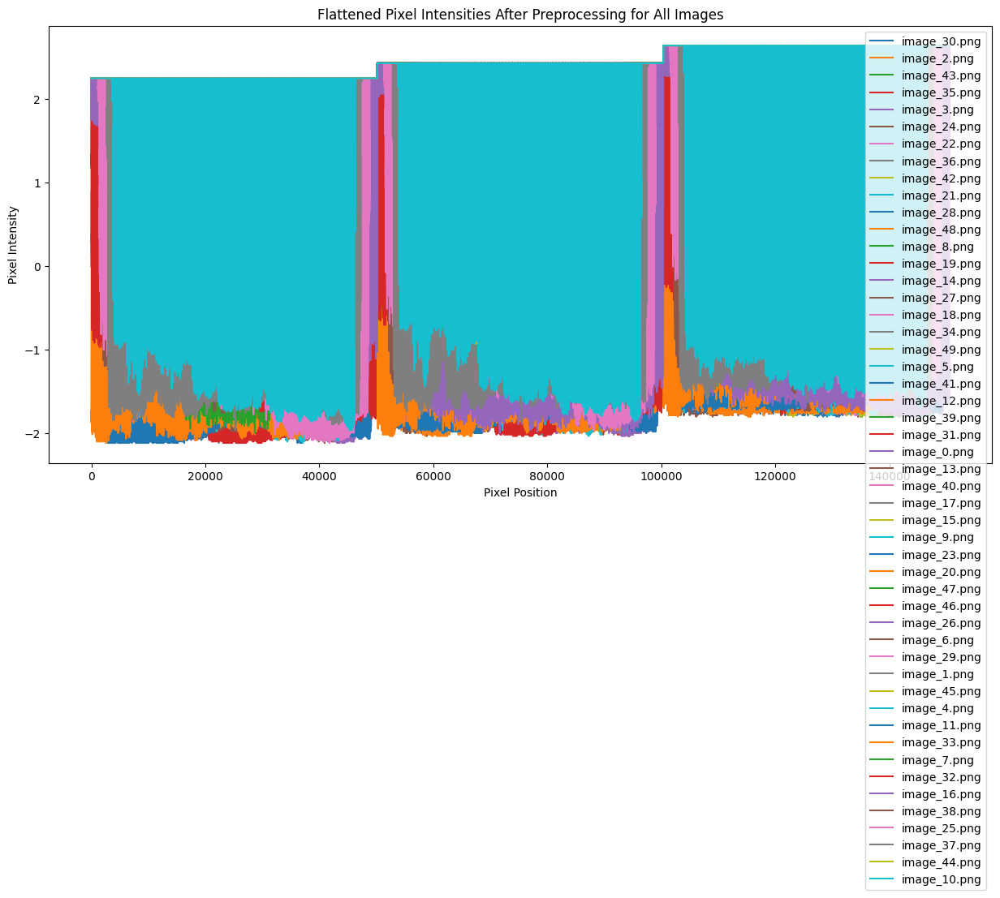

In [ ]:
# Flattening the images + visualizing the effects

import os
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import torch

# Assuming preprocess is defined as in the previous code
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Directory where the converted PDF images are stored
image_dir = '/content/pdf_images/'

# List all image files
image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]

# Prepare the plot
plt.figure(figsize=(15, 7))
plt.title('Flattened Pixel Intensities After Preprocessing for All Images')

# Loop through the images, process them, and plot the tensor values
for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    image = Image.open(image_path).convert('RGB')  # Convert to RGB

    # Preprocess the image
    image_tensor = preprocess(image)

    # Flatten the tensor to 1D for plotting
    image_tensor_flat = image_tensor.view(-1).numpy()

    # Plot the flattened tensor values
    plt.plot(image_tensor_flat, label=f'{image_file}')

# Add labels and legend
plt.xlabel('Pixel Position')
plt.ylabel('Pixel Intensity')
plt.legend()
plt.show()

In [ ]:
# Loading pretrained AlexNet

labels = {int(key):value for (key, value) in requests.get('https://s3.amazonaws.com/mlpipes/pytorch-quick-start/labels.json').json().items()}

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

model = alexnet(pretrained=True).to(device)
model.eval();

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.



In [ ]:
# Labels

labels

{0: 'tench, Tinca tinca',
 1: 'goldfish, Carassius auratus',
 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 3: 'tiger shark, Galeocerdo cuvieri',
 4: 'hammerhead, hammerhead shark',
 5: 'electric ray, crampfish, numbfish, torpedo',
 6: 'stingray',
 7: 'cock',
 8: 'hen',
 9: 'ostrich, Struthio camelus',
 10: 'brambling, Fringilla montifringilla',
 11: 'goldfinch, Carduelis carduelis',
 12: 'house finch, linnet, Carpodacus mexicanus',
 13: 'junco, snowbird',
 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 15: 'robin, American robin, Turdus migratorius',
 16: 'bulbul',
 17: 'jay',
 18: 'magpie',
 19: 'chickadee',
 20: 'water ouzel, dipper',
 21: 'kite',
 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',
 23: 'vulture',
 24: 'great grey owl, great gray owl, Strix nebulosa',
 25: 'European fire salamander, Salamandra salamandra',
 26: 'common newt, Triturus vulgaris',
 27: 'eft',
 28: 'spotted salamander, Ambystoma 

In [ ]:
# Classifying and labeling the images - initial

import os
import torch
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt

# Load the pre-trained AlexNet model
model = models.alexnet(pretrained=True).to(device)
model.eval()  # Set the model to evaluation mode

# Define the preprocess transformation according to AlexNet standards
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Directory where the converted PDF images are stored
image_dir = '/content/pdf_images/'

# List all image files
image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]

# Initialize the list to hold processed images
images = []

# Loop through the images, process them
for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    image = Image.open(image_path).convert('RGB')
    image_tensor = preprocess(image)
    images.append(image_tensor)

# Create a tensor batch from the list of images
images_tensor = torch.stack(images)

# Check if a GPU is available and if so, move the model and images to GPU
if torch.cuda.is_available():
    model.cuda()
    images_tensor = images_tensor.cuda()

# Get predictions
with torch.no_grad():
    outputs = model(images_tensor)

# Get the top prediction for each image
_, predicted_indices = torch.max(outputs, 1)

# Assuming you have a dictionary `labels` mapping indices to class names
# Example: labels = {0: 'Class0', 1: 'Class1', ...}

# Print predictions
for i, idx in enumerate(predicted_indices):
    # Print the index of the prediction and the corresponding label
    print(f'Image: {image_files[i]}, Class index: {idx.item()}, Label: {labels[idx.item()]}')

Image: image_30.png, Class index: 975, Label: lakeside, lakeshore
Image: image_2.png, Class index: 953, Label: pineapple, ananas
Image: image_43.png, Class index: 972, Label: cliff, drop, drop-off
Image: image_35.png, Class index: 974, Label: geyser
Image: image_3.png, Class index: 664, Label: monitor
Image: image_24.png, Class index: 984, Label: rapeseed
Image: image_22.png, Class index: 975, Label: lakeside, lakeshore
Image: image_36.png, Class index: 976, Label: promontory, headland, head, foreland
Image: image_42.png, Class index: 425, Label: barn
Image: image_21.png, Class index: 599, Label: honeycomb
Image: image_28.png, Class index: 233, Label: Bouvier des Flandres, Bouviers des Flandres
Image: image_48.png, Class index: 984, Label: rapeseed
Image: image_8.png, Class index: 975, Label: lakeside, lakeshore
Image: image_19.png, Class index: 975, Label: lakeside, lakeshore
Image: image_14.png, Class index: 703, Label: park bench
Image: image_27.png, Class index: 972, Label: cliff, 

In [ ]:
# Training the model on the FPR dataset

import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import os

# Check if a GPU is available and set the device accordingly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define a custom dataset class
class CustomImageDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Directory where the converted PDF images are stored
image_dir = '/content/pdf_images/'  # Adjust this if the directory is different

# List all image files
image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')]

# Assuming the first 25 images are regular trees and the next 25 are casuarina trees
labels_list = [0]*25 + [1]*25  # 0 for regular tree, 1 for casuarina

# Define the transforms
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Create the custom datasets
dataset = CustomImageDataset(image_files, labels_list, transform=transform)

# Split the dataset into training and validation sets
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [train_size, val_size])

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

# Load the pre-trained AlexNet model
model = models.alexnet(pretrained=True)

# Modify the classifier for the new number of classes (2 in your case)
model.classifier[6] = nn.Linear(model.classifier[6].in_features, 2)

# Move the model to the device (GPU or CPU)
model = model.to(device)

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Training loop
num_epochs = 25  # You can change this value
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Print the loss averaged over the epoch
   # print(f'Epoch {epoch+1}/{num_epochs}, Loss: {running_loss / len(train_loader)}')

    # Validation step
    model.eval()  # Set model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    val_accuracy = correct / total
    print(f'accuracy: {100 * val_accuracy}%')

# Save the trained model
torch.save(model.state_dict(), '/content/alexnet_fine_tuned.pth')

accuracy: 50.0%
accuracy: 70.0%
accuracy: 60.0%
accuracy: 50.0%
accuracy: 70.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 60.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 40.0%


In [ ]:
# Initial model vs fine-tuned model

# Data Augmentation:
#
# First Code: In the first code, there is no data augmentation applied to the images. It uses a basic set of transformations, including resizing, center cropping, and normalization.
#
# Second Code: The second code incorporates data augmentation during training. It uses transformations such as random horizontal flip, random rotation, and random resized crop in addition to the basic transformations. This helps the model generalize better by exposing it to a more diverse set of training samples.
#
# Dataset Splitting:
#
# First Code: The first code splits the dataset into training and validation sets using torch.utils.data.random_split. It randomly shuffles the data and then assigns 80% to training and 20% to validation.
#
# Second Code: The second code manually splits the dataset based on a specified proportion (80% training and 20% validation). It doesn't shuffle the data explicitly but relies on the order of files in the directory.
#
# Fine-Tuning Strategy:
#
# First Code: In the first code, the model is fine-tuned with the entire network's weights trainable. It uses optim.SGD(model.parameters(), lr=0.001, momentum=0.9) to optimize all parameters in the model.
#
# Second Code: In the second code, the model is fine-tuned in a more layered manner. It freezes the weights of the initial layers (model.features[:-6]) and only allows the last six layers (model.features[-6:]) to be fine-tuned. It also uses a more customized optimizer, specifying different learning rates for these two groups of layers.
#
# Output Layer Modification:
#
# Both codes modify the classifier of the model to match the new number of classes (2 in your case).
# Loss Calculation:
#
# Both codes use the same loss function (nn.CrossEntropyLoss) and an SGD optimizer for training. The second code, however, uses a more complex optimizer setup with different learning rates for different parameter groups.


In [ ]:
'''
Fine-tuning cliffnotes:
- data augmentation via transforms - diversify training samples
- maintain 80-20 split + exclude data shuffling
- "layered" fine-tuning
- more complex optimizer, different learning rates
'''

import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import os

# Check if a GPU is available and set the device accordingly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define a custom dataset class
class CustomImageDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(image_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# Directory where the converted PDF images are stored
image_dir = '/content/pdf_images/'

# List all image files
image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')]

# Assuming the first 25 images are regular trees and the next 25 are casuarina trees
labels_list = [0]*25 + [1]*25  # 0 for regular tree, 1 for casuarina

# Define the transforms
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

val_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Split the dataset into training and validation sets
train_size = int(0.8 * len(image_files))
val_size = len(image_files) - train_size

# Create datasets with the respective transforms
train_dataset = CustomImageDataset(image_files[:train_size], labels_list[:train_size], transform=train_transform)
val_dataset = CustomImageDataset(image_files[train_size:], labels_list[train_size:], transform=val_transform)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

# Load the pre-trained AlexNet model
model = models.alexnet(pretrained=True)

# Fine-tune more layers of the model
for param in model.features[:-6].parameters():
    param.requires_grad = False
for param in model.features[-6:].parameters():
    param.requires_grad = True

# Modify the classifier for the new number of classes (2 in your case)
model.classifier[6] = nn.Linear(model.classifier[6].in_features, 2)

# Move the model to the device (GPU or CPU)
model = model.to(device)

# Define the loss function and optimizer
optimizer = optim.SGD([
    {'params': model.features[-6:].parameters(), 'lr': 0.001},
    {'params': model.classifier.parameters(), 'lr': 0.001}
], lr=0.0001, momentum=0.9)
criterion = nn.CrossEntropyLoss()

# Training loop
num_epochs = 25  # You can change this value
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

    # Validation step
    model.eval()  # Set model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    val_accuracy = correct / total
    print(f'accuracy: {100 * val_accuracy}%')

# Save the trained model
torch.save(model.state_dict(), '/content/alexnet_fine_tuned.pth')

accuracy: 40.0%
accuracy: 40.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 40.0%
accuracy: 40.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 70.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%
accuracy: 50.0%


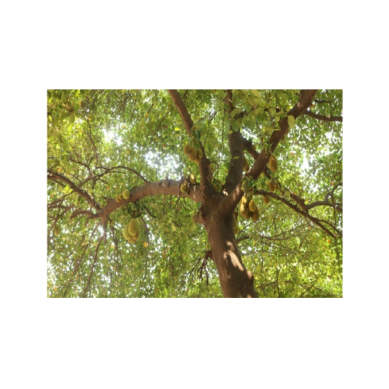

The image is classified as: not an Australian pine.






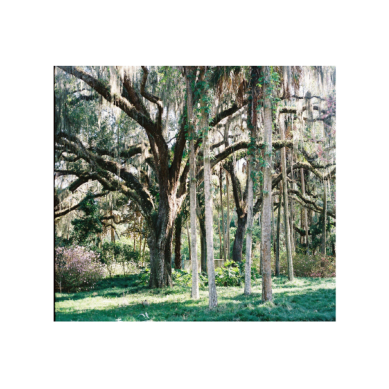

The image is classified as: Australian pine!






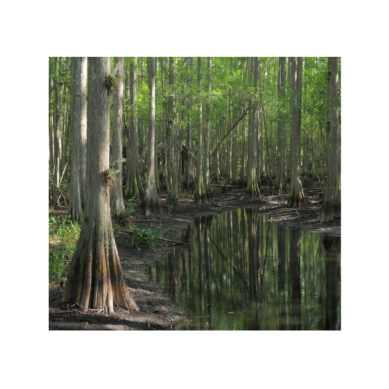

The image is classified as: Australian pine!






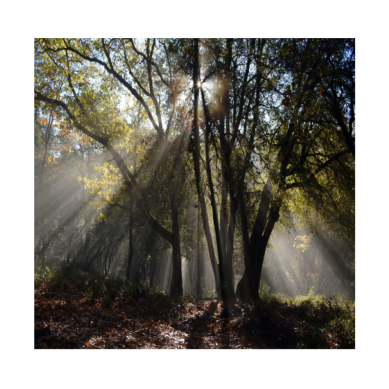

The image is classified as: Australian pine!






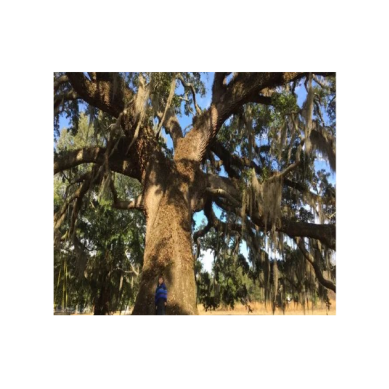

The image is classified as: not an Australian pine.






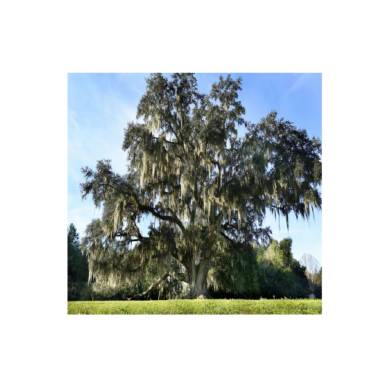

The image is classified as: Australian pine!






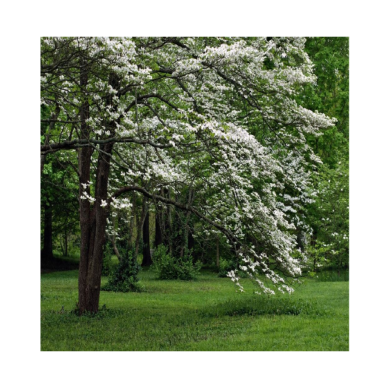

The image is classified as: not an Australian pine.






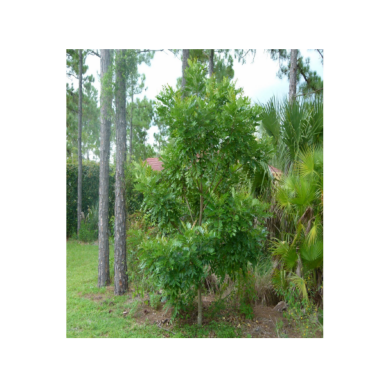

The image is classified as: Australian pine!






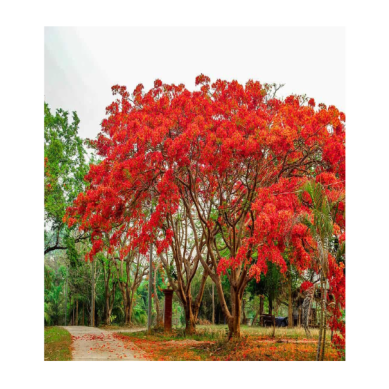

The image is classified as: Australian pine!






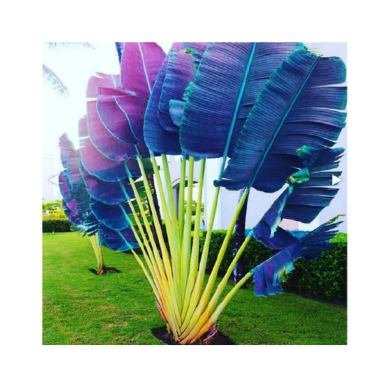

The image is classified as: Australian pine!






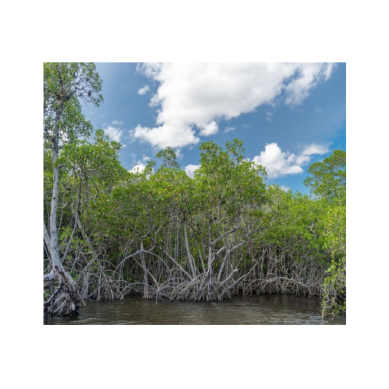

The image is classified as: not an Australian pine.






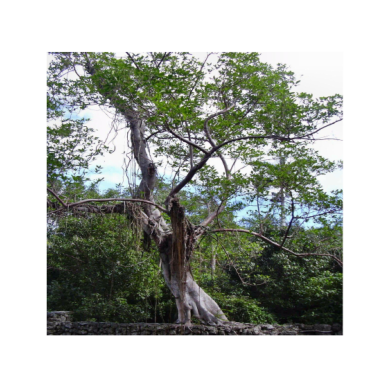

The image is classified as: not an Australian pine.






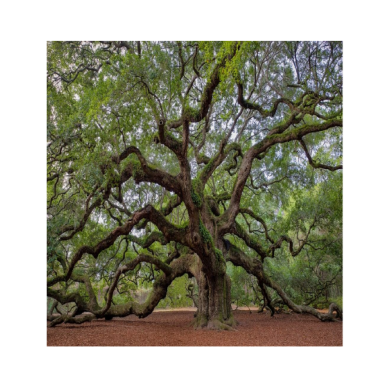

The image is classified as: not an Australian pine.






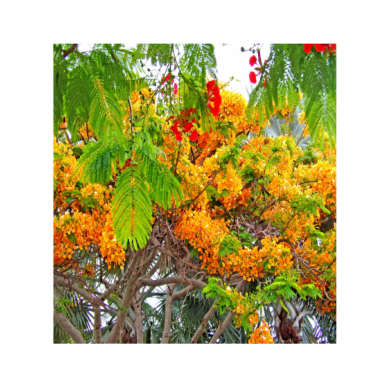

The image is classified as: Australian pine!






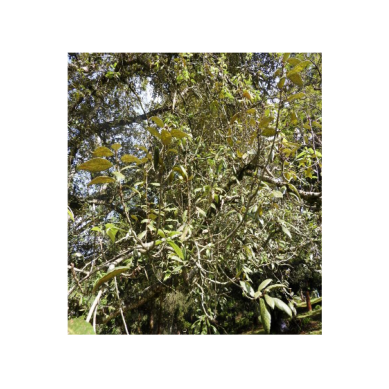

The image is classified as: not an Australian pine.






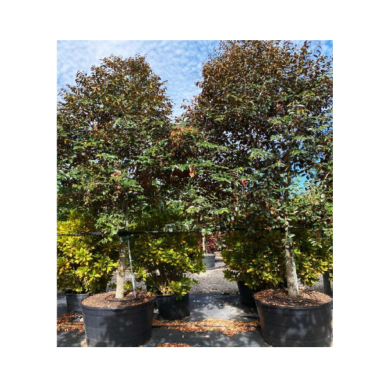

The image is classified as: not an Australian pine.






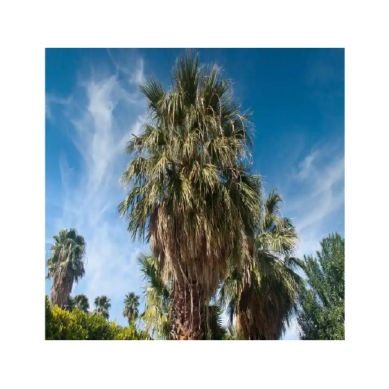

The image is classified as: Australian pine!






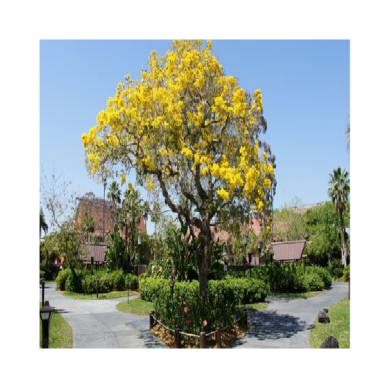

The image is classified as: not an Australian pine.






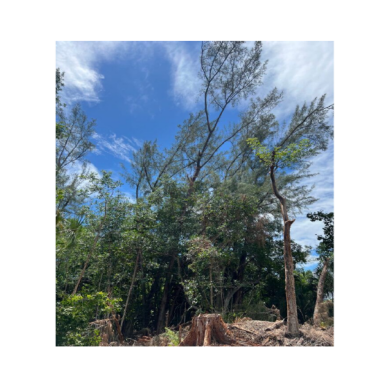

The image is classified as: not an Australian pine.






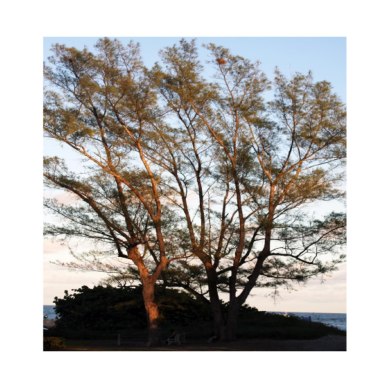

The image is classified as: Australian pine!






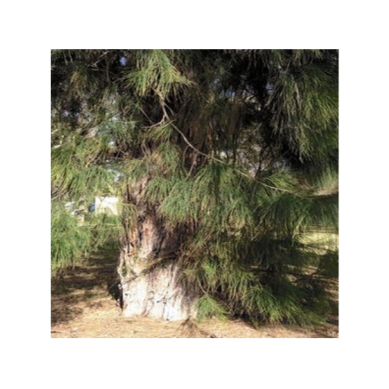

The image is classified as: not an Australian pine.






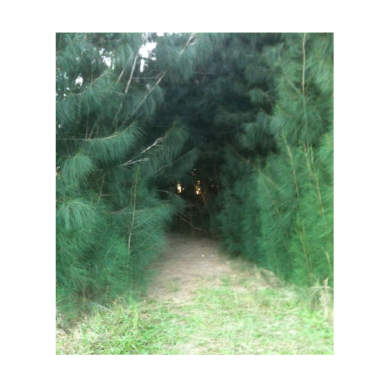

The image is classified as: not an Australian pine.






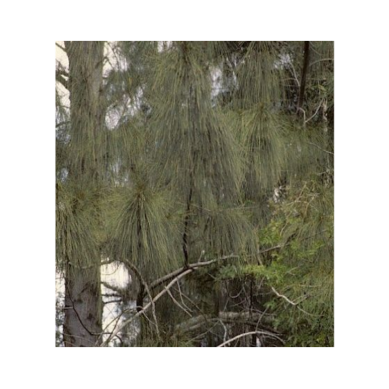

The image is classified as: Australian pine!






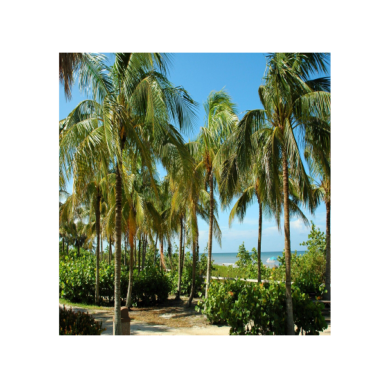

The image is classified as: not an Australian pine.






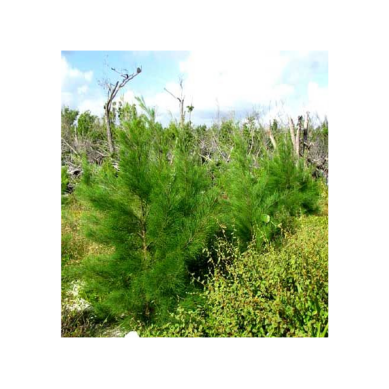

The image is classified as: not an Australian pine.






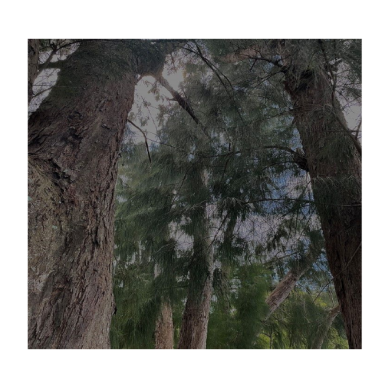

The image is classified as: not an Australian pine.






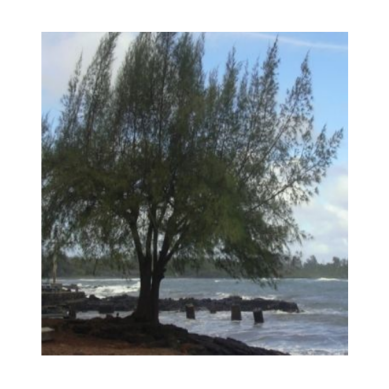

The image is classified as: not an Australian pine.






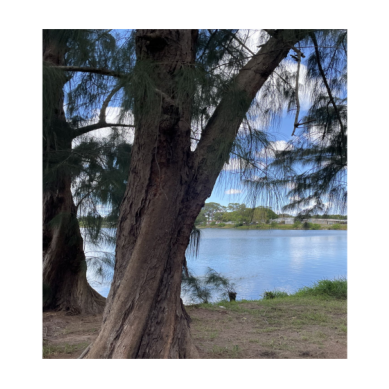

The image is classified as: not an Australian pine.






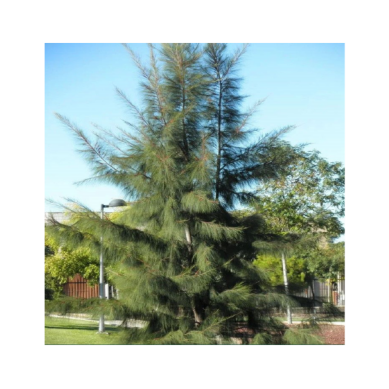

The image is classified as: not an Australian pine.






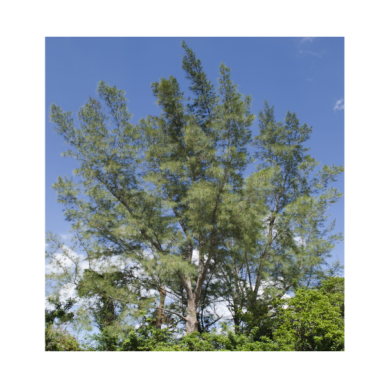

The image is classified as: not an Australian pine.






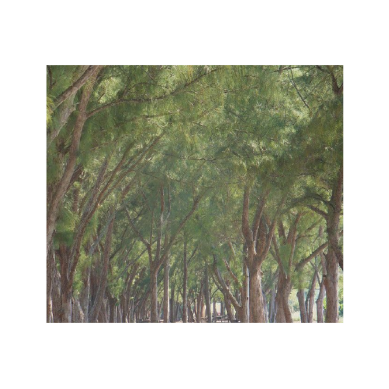

The image is classified as: not an Australian pine.






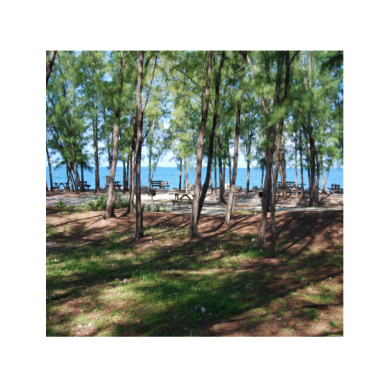

The image is classified as: not an Australian pine.






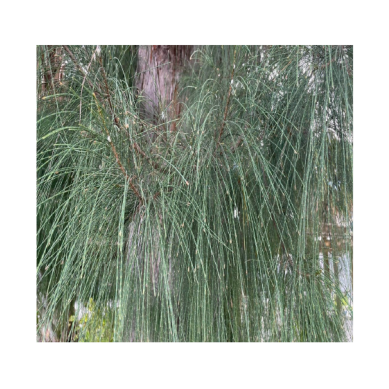

The image is classified as: Australian pine!






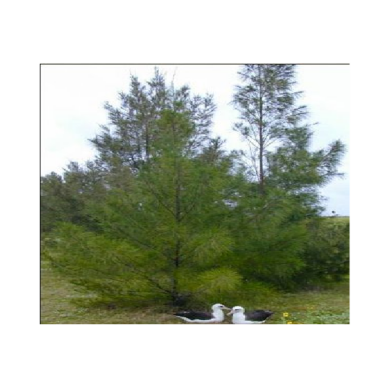

The image is classified as: not an Australian pine.






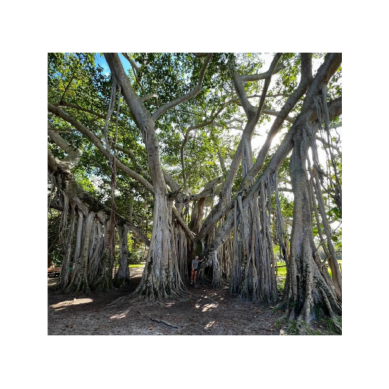

The image is classified as: Australian pine!






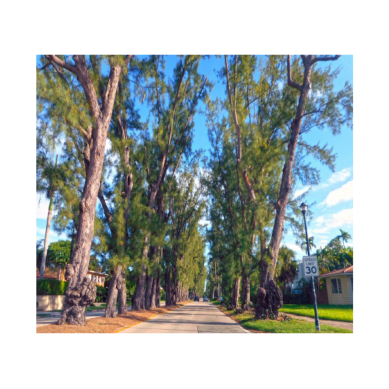

The image is classified as: Australian pine!






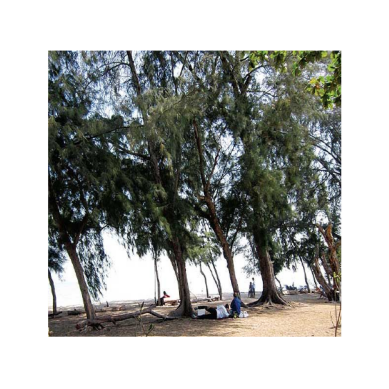

The image is classified as: not an Australian pine.






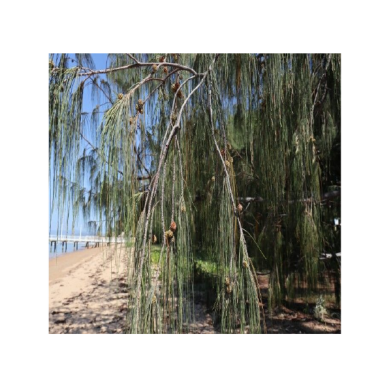

The image is classified as: not an Australian pine.






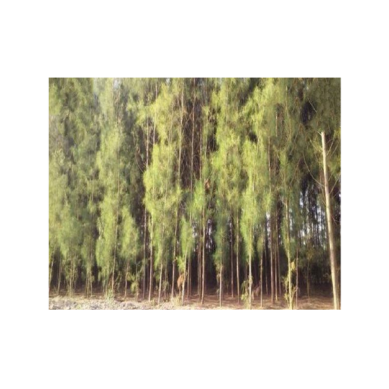

The image is classified as: not an Australian pine.






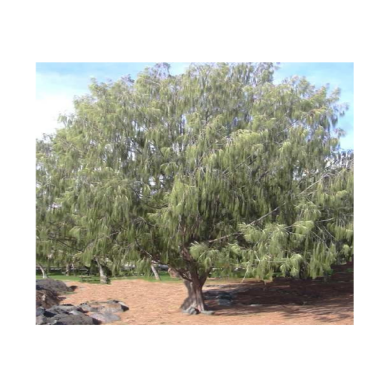

The image is classified as: not an Australian pine.






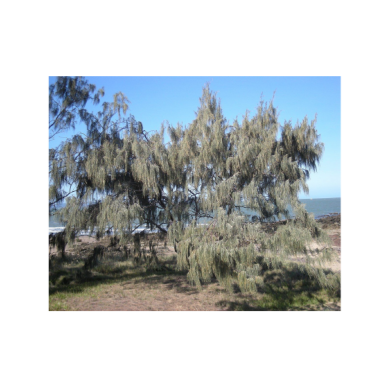

The image is classified as: Australian pine!






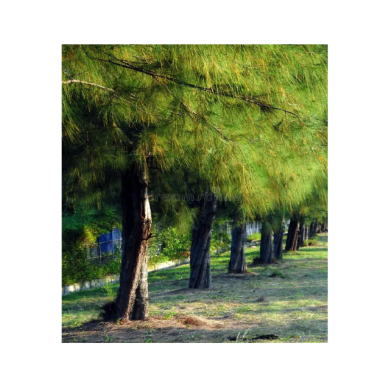

The image is classified as: Australian pine!






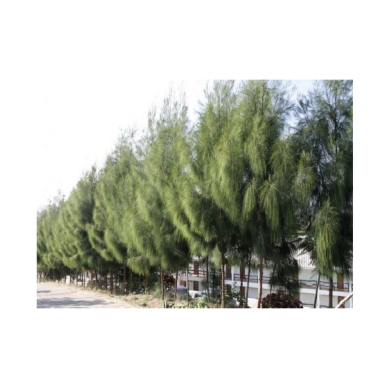

The image is classified as: Australian pine!






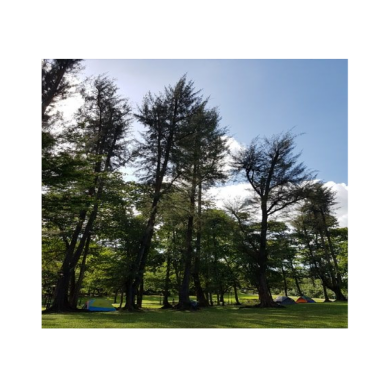

The image is classified as: not an Australian pine.






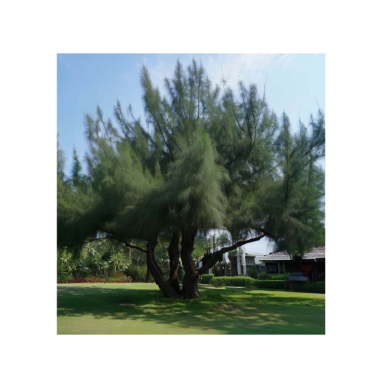

The image is classified as: not an Australian pine.






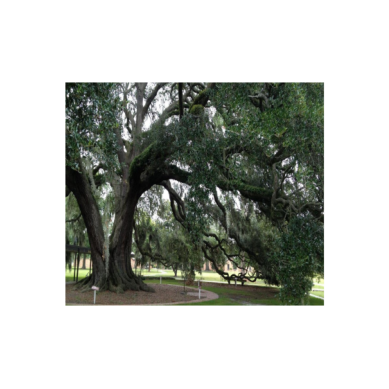

The image is classified as: not an Australian pine.






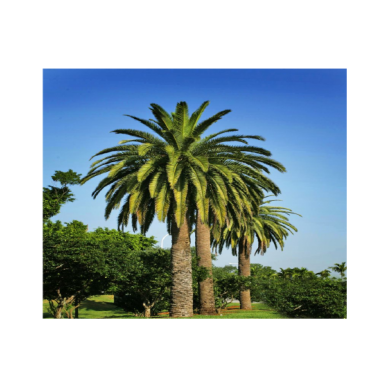

The image is classified as: Australian pine!






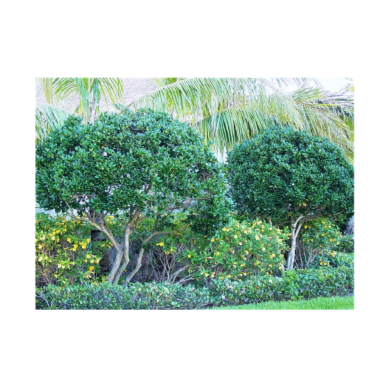

The image is classified as: Australian pine!






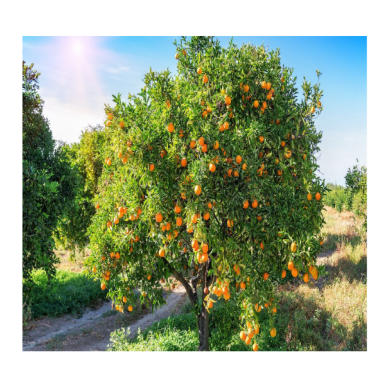

The image is classified as: not an Australian pine.






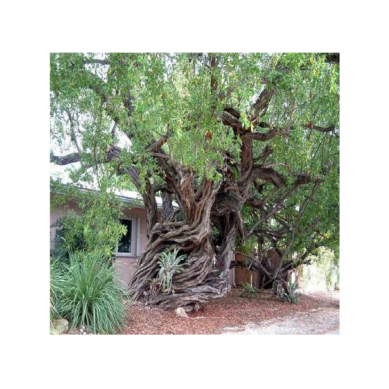

The image is classified as: Australian pine!






In [ ]:
# Classifying and labeling images from the dataset using trained model

import torch
from torchvision import models, transforms
from PIL import Image
import os
import matplotlib.pyplot as plt
import time

# Define the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to load the trained model weights
def load_trained_model(model_path):
    # Initialize the model structure identical to how it was during training
    model = models.alexnet(pretrained=True)
    model.classifier[6] = nn.Linear(model.classifier[6].in_features, 2)  # Adjust for binary classification

    # Load the saved weights into the model
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()  # Set the model to evaluation mode
    return model

# Load your trained model
trained_model = load_trained_model('/content/alexnet_fine_tuned.pth')

# Function to predict a single image, display it, and add spacing
def predict_and_display_image(image_path, model, transform):
    # Load and transform the image
    image = Image.open(image_path).convert('RGB')
    image_tensor = transform(image).unsqueeze(0)  # Add batch dimension
    image_tensor = image_tensor.to(device)

    # Display the image
    plt.imshow(image)
    plt.axis('off')  # Hide axes
    plt.show()

    # Predict the class of the image
    with torch.no_grad():
        outputs = model(image_tensor)
        _, predicted = torch.max(outputs, 1)
        class_index = predicted.item()
        class_label = 'Australian pine!' if class_index == 1 else 'not an Australian pine.'

    # Print the prediction and add space for neatness
    print(f"The image is classified as: {class_label}\n")
    # Adding space after the label for neatness
    print("\n" * 2)
    # Or use time.sleep(2) for a 2-second pause if desired

# Define the transform for the prediction
predict_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Directory where the images are stored
output_image_dir = '/content/pdf_images/'

# Classify each image in the output directory, display them, and add spacing
for image_file in sorted(os.listdir(output_image_dir)):
    image_path = os.path.join(output_image_dir, image_file)
    predict_and_display_image(image_path, trained_model, predict_transform)
    # Uncomment the line below if you prefer a pause instead of just whitespace
    # time.sleep(2)

In [ ]:
!pip install wandb
import wandb

In [ ]:
'''

import wandb

# Initialize wandb
wandb.init(project="alexnet_visualization", entity="ajoseph03")

# Prepare data for batch logging
data_to_log = {"Average Weight": weights_avg.tolist(), "Bias": final_layer_biases.tolist()}

# Batch log the data
wandb.log(data_to_log)

# Finish the wandb run
wandb.finish()

'''

'\n\nimport wandb\n\n# Initialize wandb\nwandb.init(project="alexnet_visualization", entity="ajoseph03")\n\n# Prepare data for batch logging\ndata_to_log = {"Average Weight": weights_avg.tolist(), "Bias": final_layer_biases.tolist()}\n\n# Batch log the data\nwandb.log(data_to_log)\n\n# Finish the wandb run\nwandb.finish()\n\n'

ValueError: ignored

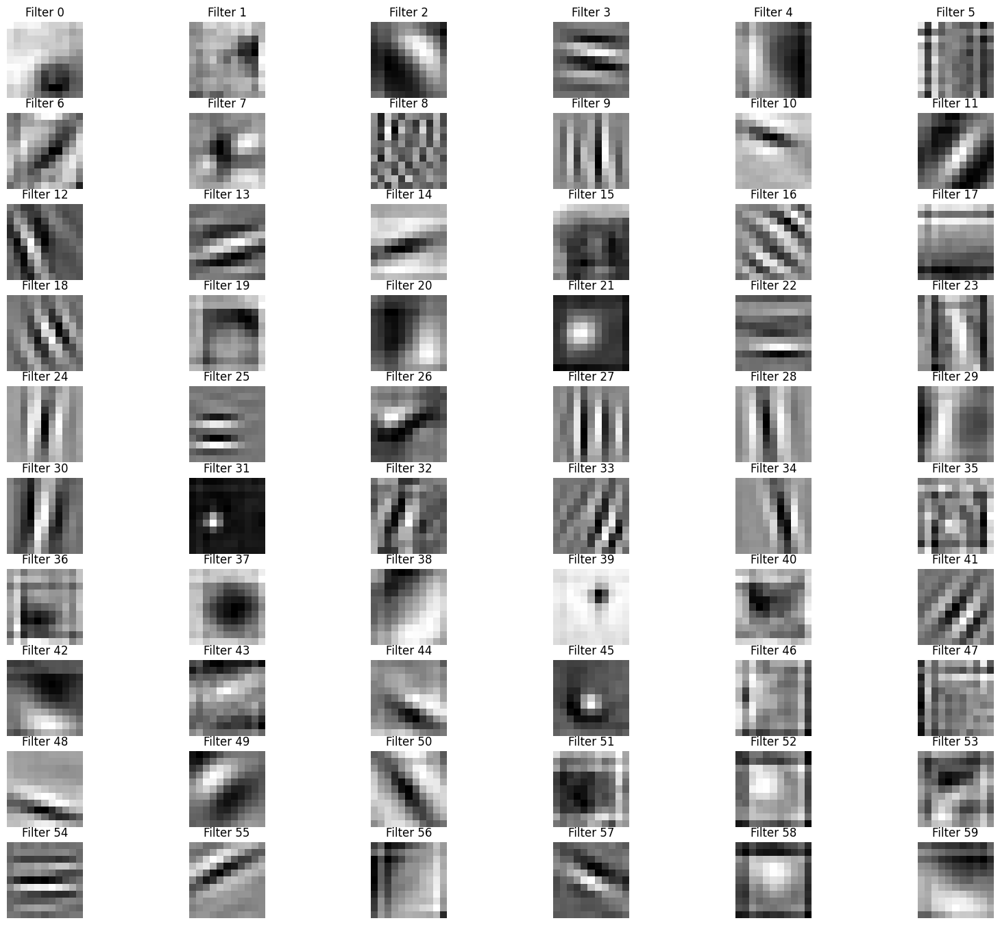

In [ ]:
import matplotlib.pyplot as plt

def plot_filters_single_channel_big(t):
    n_filters = t.shape[0]
    rows = int(n_filters / 6)
    plt.figure(figsize=(20, 17))
    for i in range(n_filters):
        plt.subplot(rows, 6, i+1)
        plt.imshow(t[i][0], cmap="gray")
        plt.axis('off')
        plt.title(f'Filter {i}')
    plt.show()

# Visualize the filters of the first convolutional layer
plot_filters_single_channel_big(model.features[0].weight.data.cpu())

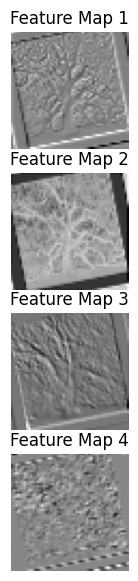

In [ ]:
# Feature maps

def plot_feature_maps(model, loader, layer):
    model.eval()
    images, _ = next(iter(loader))

    # Move images to the same device as the model
    images = images.to(device)

    # Pass the images through the model up to the specified layer
    with torch.no_grad():
        output = images
        for name, module in model.features.named_children():
            output = module(output)
            if name == layer:
                break

    # Plot the feature maps
    num_feature_maps = output.shape[1]  # Number of feature maps in the layer
    fig, axes = plt.subplots(min(num_feature_maps, 4), 1, figsize=(20, 7))
    for i in range(min(num_feature_maps, 4)):
        axes[i].imshow(output[0][i].cpu().detach(), cmap='gray')
        axes[i].axis('off')
        axes[i].set_title(f'Feature Map {i+1}')
    plt.show()

# Example: Visualize feature maps from the first layer for some images
plot_feature_maps(model, train_loader, '0')


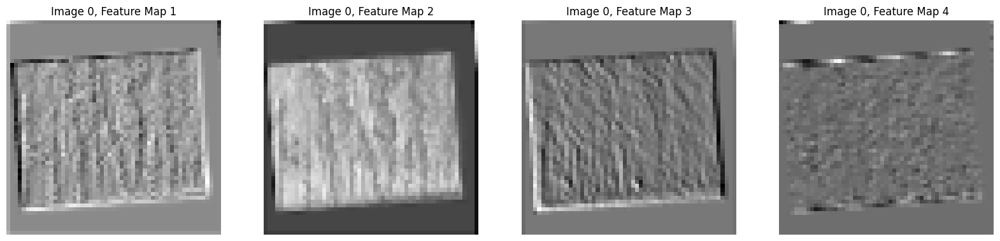

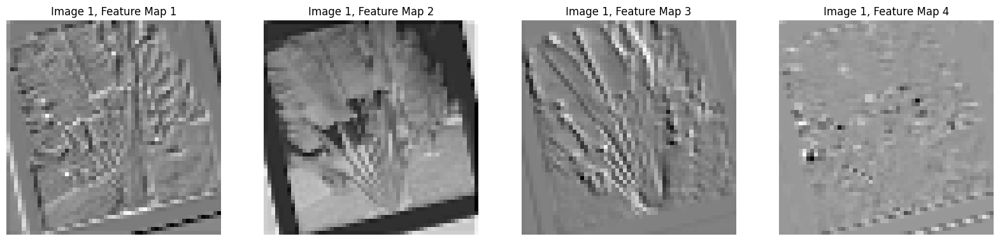

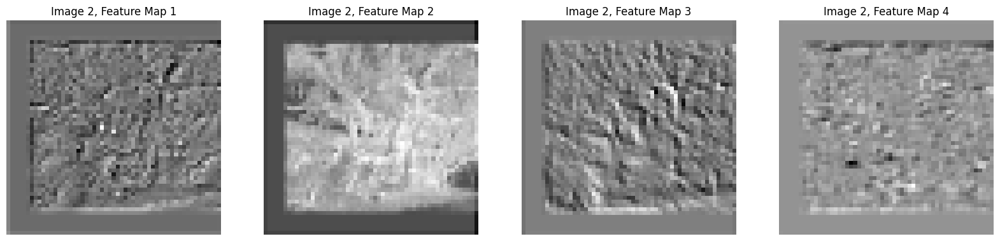

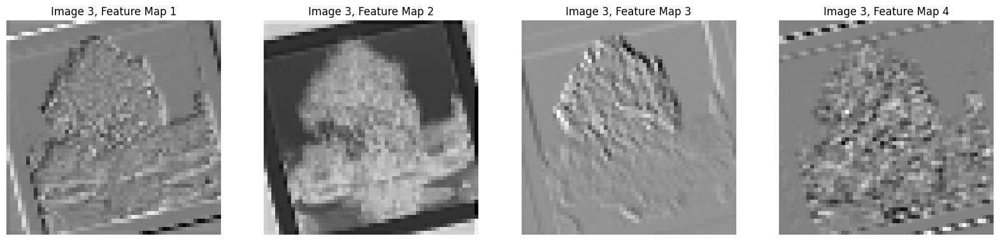

In [ ]:
# More features for one batch

def plot_feature_maps_for_batch(model, batch_images, layer_name):
    model.eval()
    # Ensure the images are on the same device as the model
    batch_images = batch_images.to(device)

    with torch.no_grad():
        # Pass the images through the model up to the specified layer
        output = batch_images
        for name, module in model.features.named_children():
            output = module(output)
            if name == layer_name:
                break

        # Plot the feature maps for each image in the batch
        num_feature_maps = output.shape[1]  # Number of feature maps in the layer
        for img_index in range(output.shape[0]):  # Iterate over images in the batch
            fig, axes = plt.subplots(1, min(num_feature_maps, 4), figsize=(20, 5))
            for i in range(min(num_feature_maps, 4)):
                if num_feature_maps > 1:
                    ax = axes[i]
                else:
                    ax = axes
                feature_map = output[img_index][i].cpu().detach()
                ax.imshow(feature_map, cmap='gray')
                ax.axis('off')
                ax.set_title(f'Image {img_index}, Feature Map {i+1}')
            plt.show()

# Example: Visualize feature maps for each image in the first batch
first_batch_images, _ = next(iter(train_loader))
plot_feature_maps_for_batch(model, first_batch_images, '0')

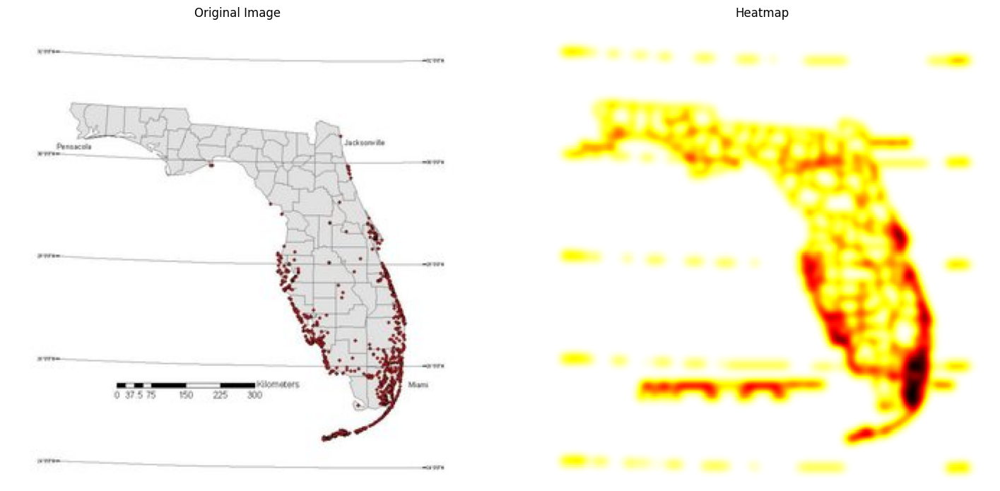

In [ ]:
# Creating a heatmap from exsiting data; better visualization?

import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter
from PIL import Image

# Load the image
image_path = '/content/fpr1.jpg'  # Adjust path if necessary
img = Image.open(image_path)

# Convert the image to a numpy array
img_array = np.array(img)

# Assuming red dots are bright enough to be differentiated from the map
# We will extract the red channel and threshold it
red_channel = img_array[:, :, 0]

# Normalize the red channel by the maximum value to enhance the dots
normalized_red = red_channel / red_channel.max()

# Threshold the red channel to get the binary mask of the dots
# Threshold chosen by visually inspecting the red channel
threshold = 0.8
binary_mask = normalized_red > threshold

# Generate a heatmap from the binary mask
heatmap = gaussian_filter(binary_mask.astype(float), sigma=3)

# Plotting both original and heatmap side by side
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

# Original image
ax[0].imshow(img_array)
ax[0].set_title('Original Image')
ax[0].axis('off')

# Heatmap
ax[1].imshow(heatmap, cmap='hot', interpolation='nearest')
ax[1].set_title('Heatmap')
ax[1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Example plotly dashboard for further analysis (more data required)

import plotly.express as px
from PIL import Image

# Load the image from the Colab session storage
image_path = '/content/fpr2.png'
img = Image.open(image_path)

# Convert the image into an array
img_array = np.array(img)

# Create a figure using Plotly Express to display the image
fig = px.imshow(img_array)
fig.update_layout(
    title='Interactive Species Distribution Map',
    width=600,  # Adjust the size as needed
    height=600,
    margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
)

# Show the figure
fig.show()

In [ ]:
"""
Interpreting the Simplified Beach Erosion Model:

This Python script visualizes a simplified model of beach erosion over time using 3D plotting.

1. The Model's Formula:
   Erosion Rate = Wave Energy * Sediment Availability * Time
   This formula calculates the rate of beach erosion based on three factors:
   - Wave Energy: A constant representing the average energy of waves affecting the beach.
   - Sediment Availability: A constant denoting how easily the beach's material can be eroded.
   - Time: The period over which erosion is being calculated.

2. Key Variables:
   - wave_energy: A constant for wave energy, set to 0.05 in this model.
   - sediment_availability: A constant for sediment availability, set to 0.8.
   - time_steps: A list of time points (0, 5, 10, 15, 20) at which erosion is simulated.

3. Initial Beach Profile:
   - A simple linear slope is used to represent the initial beach profile, defined over a range of distances from the shoreline.

4. simulate_erosion Function:
   - This function applies the erosion rate to the initial beach profile at different time steps, modifying the beach profile based on the calculated erosion.

5. 3D Plot Interpretation:
   - X-Axis (Distance from Shoreline): Represents the horizontal distance from the water's edge into the land.
   - Y-Axis (Time): Indicates different time steps at which the erosion is being calculated and visualized.
   - Z-Axis (Beach Height): Shows the vertical height of the beach profile, indicating the amount of beach material present.
   - The plot shows multiple lines, each representing the beach profile at a different time step. As time progresses (moving along the y-axis), the lines show how the beach height decreases due to erosion.

6. Visualizing Erosion Over Time:
   - The gradual lowering of the beach profile lines along the z-axis (beach height) as time increases (along the y-axis) visually demonstrates the process of beach erosion.

Remember, this is a simplified model for educational purposes and does not account for the complex interplay of all factors affecting real-world beach erosion.
"""


"\nInterpreting the Simplified Beach Erosion Model:\n\nThis Python script visualizes a simplified model of beach erosion over time using 3D plotting.\n\n1. The Model's Formula: \n   Erosion Rate = Wave Energy * Sediment Availability * Time\n   This formula calculates the rate of beach erosion based on three factors:\n   - Wave Energy: A constant representing the average energy of waves affecting the beach.\n   - Sediment Availability: A constant denoting how easily the beach's material can be eroded.\n   - Time: The period over which erosion is being calculated.\n\n2. Key Variables:\n   - wave_energy: A constant for wave energy, set to 0.05 in this model.\n   - sediment_availability: A constant for sediment availability, set to 0.8.\n   - time_steps: A list of time points (0, 5, 10, 15, 20) at which erosion is simulated.\n\n3. Initial Beach Profile:\n   - A simple linear slope is used to represent the initial beach profile, defined over a range of distances from the shoreline.\n\n4. si

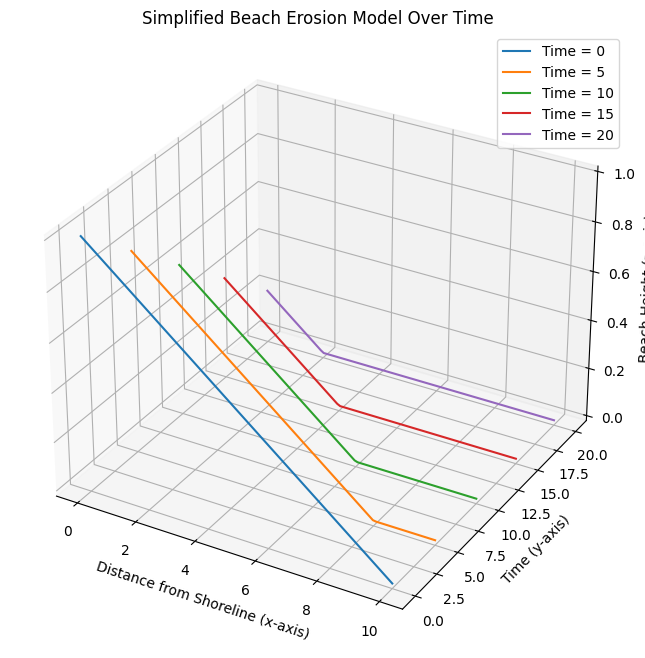

In [ ]:
# A simple, hypothetical formula to calculate the rate of beach erosion over time + visualization

'''
Erosion Rate = Wave Energy × Sediment Availability × Time

Decrease in height (z axis) indicates that erosion has occured
'''

# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Parameters for the model
wave_energy = 0.05  # Simplified constant for wave energy
sediment_availability = 0.8  # Simplified constant for sediment availability
time_steps = [0, 5, 10, 15, 20]  # Time steps to simulate (in arbitrary units)

# Initial beach profile: a simple slope
x = np.linspace(0, 10, 100)  # Represents distance from the shoreline
initial_beach_profile = 1 - 0.1 * x  # Initial slope of the beach

# Function to simulate erosion
def simulate_erosion(initial_profile, wave_energy, sediment_availability, time):
    """
    Simulate beach erosion.

    Erosion Rate = Wave Energy * Sediment Availability * Time
    This function applies the erosion rate to the initial beach profile.
    """
    # Calculate erosion
    erosion = wave_energy * sediment_availability * time
    # Apply erosion to the beach profile
    eroded_profile = initial_profile - erosion
    # Ensure the beach profile doesn't go below sea level (0)
    eroded_profile[eroded_profile < 0] = 0
    return eroded_profile

# Simulating erosion over different time steps
profiles = [initial_beach_profile] + [
    simulate_erosion(initial_beach_profile, wave_energy, sediment_availability, t) for t in time_steps[1:]
]

# Plotting the results in a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

for i, profile in enumerate(profiles):
    ax.plot(x, [time_steps[i]] * len(x), profile, label=f"Time = {time_steps[i]}")

# Setting axis labels and title
ax.set_xlabel('Distance from Shoreline (x-axis)')
ax.set_ylabel('Time (y-axis)')
ax.set_zlabel('Beach Height (z-axis)')
ax.set_title('Simplified Beach Erosion Model Over Time')
ax.legend()

plt.show()

In [ ]:
"""
Interpreting the Beach Erosion Visualization:

1. X-Axis (Distance from Shoreline): The x-axis represents the distance from the shoreline into the land.
   It helps in understanding how the erosion profile changes as one moves inland.

2. Y-Axis (Time): The y-axis shows the progression of time in discrete steps. Each step represents the state
   of the beach at a specific time interval. As you move from the front to the back of the graph (increasing y-values),
   you see how the beach changes over time.

3. Z-Axis (Beach Height): The z-axis indicates the height of the beach profile. Higher z-values represent more
   beach material, such as sand. Decreasing z-values show erosion and the loss of beach material.

4. Color Coding: The visualization uses color coding to differentiate between two scenarios. Blue lines represent
   the beach profile over time without Casuarina trees, while red lines represent the profile with Casuarina trees.

5. Comparing Scenarios: By examining the blue and red lines at each time step, you can compare how the beach
   profile is affected with and without the presence of Casuarina trees. Lower red lines compared to blue at the
   same time step indicate more erosion due to Casuarinas.

6. Overall Trend: Observe the general trend of the lines from the front (lower y-values) to the back (higher y-values)
   of the graph. This shows whether the beach is undergoing an increase in erosion or if the erosion rate is relatively
   constant over time.

7. Spatial Variation: Look for any variation in erosion along the x-axis. This can indicate areas that are more
   susceptible to erosion, especially in the scenario with Casuarina trees.

Note: This model is a simplified representation to illustrate the potential impact of Casuarina trees on beach erosion.
In real-world applications, many other factors would influence erosion, necessitating a more complex and detailed model.
"""

'\nInterpreting the Beach Erosion Visualization:\n\n1. X-Axis (Distance from Shoreline): The x-axis represents the distance from the shoreline into the land. \n   It helps in understanding how the erosion profile changes as one moves inland.\n\n2. Y-Axis (Time): The y-axis shows the progression of time in discrete steps. Each step represents the state \n   of the beach at a specific time interval. As you move from the front to the back of the graph (increasing y-values), \n   you see how the beach changes over time.\n\n3. Z-Axis (Beach Height): The z-axis indicates the height of the beach profile. Higher z-values represent more \n   beach material, such as sand. Decreasing z-values show erosion and the loss of beach material.\n\n4. Color Coding: The visualization uses color coding to differentiate between two scenarios. Blue lines represent \n   the beach profile over time without Casuarina trees, while red lines represent the profile with Casuarina trees.\n\n5. Comparing Scenarios: By

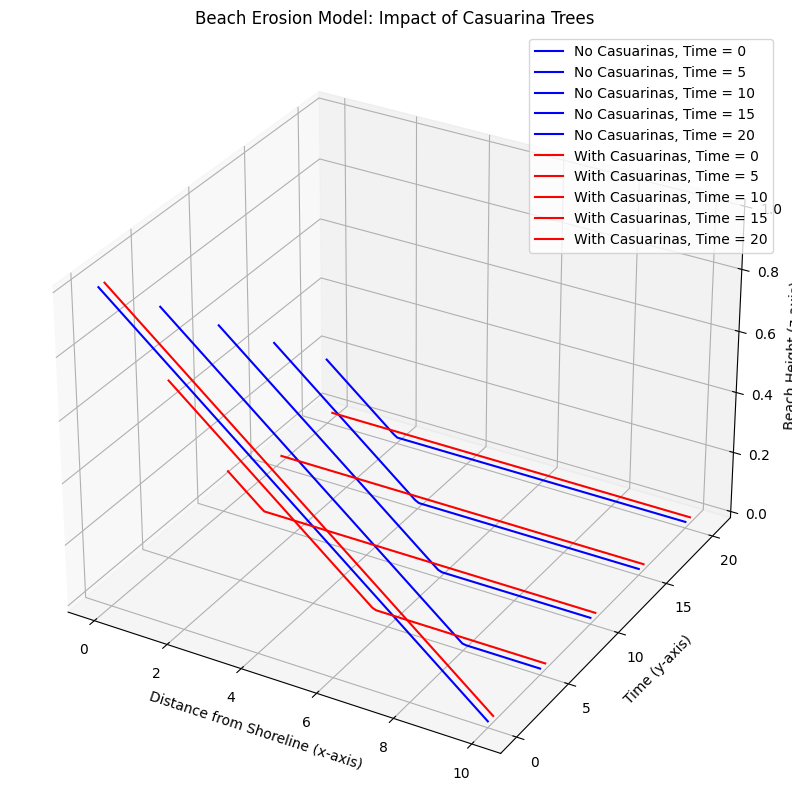

In [ ]:
# How casuarina tress could accelerate erosion - Florida beach

# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Parameters for the model
wave_energy = 0.05  # Simplified constant for wave energy
sediment_availability = 0.8  # Simplified constant for sediment availability
casuarina_impact = 0.05  # Additional erosion factor due to Casuarina trees
time_steps = [0, 5, 10, 15, 20]  # Time steps to simulate (in arbitrary units)

# Initial beach profile: a simple slope
x = np.linspace(0, 10, 100)  # Represents distance from the shoreline
initial_beach_profile = 1 - 0.1 * x  # Initial slope of the beach

# Function to simulate erosion
def simulate_erosion(initial_profile, wave_energy, sediment_availability, casuarina_impact, time, casuarinas_present):
    """
    Simulate beach erosion with and without the presence of Casuarina trees.

    Erosion Rate = Wave Energy * Sediment Availability * Time
    With Casuarinas: Additional erosion factor is applied.
    """
    # Calculate base erosion
    erosion = wave_energy * sediment_availability * time
    # Apply additional erosion if Casuarinas are present
    if casuarinas_present:
        erosion += casuarina_impact * time
    # Apply erosion to the beach profile
    eroded_profile = initial_profile - erosion
    # Ensure the beach profile doesn't go below sea level (0)
    eroded_profile[eroded_profile < 0] = 0
    return eroded_profile

# Simulating erosion over different time steps for both scenarios
profiles_no_casuarinas = [initial_beach_profile] + [
    simulate_erosion(initial_beach_profile, wave_energy, sediment_availability, casuarina_impact, t, False) for t in time_steps[1:]
]

profiles_with_casuarinas = [initial_beach_profile] + [
    simulate_erosion(initial_beach_profile, wave_energy, sediment_availability, casuarina_impact, t, True) for t in time_steps[1:]
]

# Plotting the results in a 3D plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Plot for scenario without Casuarinas
for i, profile in enumerate(profiles_no_casuarinas):
    ax.plot(x, [time_steps[i]] * len(x), profile, label=f"No Casuarinas, Time = {time_steps[i]}", color='blue')

# Plot for scenario with Casuarinas
for i, profile in enumerate(profiles_with_casuarinas):
    ax.plot(x, [time_steps[i] + 0.5] * len(x), profile, label=f"With Casuarinas, Time = {time_steps[i]}", color='red')

# Setting axis labels and title
ax.set_xlabel('Distance from Shoreline (x-axis)')
ax.set_ylabel('Time (y-axis)')
ax.set_zlabel('Beach Height (z-axis)')
ax.set_title('Beach Erosion Model: Impact of Casuarina Trees')
ax.legend()

plt.show()

In [ ]:
"""
Interpreting the Plot and Animation of Population Changes:

This Python script visualizes the hypothetical changes in the populations of native flora, fauna, and invasive Casuarina trees over a 20-year period using a line graph animation.

1. Plot Setup:
   - The X-axis represents time in years, spanning from 0 to 20 years.
   - The Y-axis represents the health or population level of each group, scaled from 0 (no population) to 1 (full, healthy population).
   - Three lines in the plot represent different populations:
     - Green Line: Native Flora
     - Blue Line: Native Fauna
     - Red Line: Casuarina Trees

2. Understanding the Animation:
   - As the animation progresses, it simulates the passage of time over 20 years.
   - Each line dynamically changes to represent the population health of each group at each point in time.

3. Interpretation of Changes:
   - Native Flora (Green Line): Shows the decline in native flora due to the growing presence of Casuarina trees. A downward trend indicates decreasing flora health.
   - Native Fauna (Blue Line): Depicts the health of native fauna, assumed to be dependent on flora health. It follows a similar but slightly more pronounced downward trend than flora.
   - Casuarina Trees (Red Line): Illustrates the growth of the invasive Casuarina population. An upward trend indicates increasing numbers or health of Casuarina trees.

4. Key Assumptions:
   - The health of the native fauna is directly proportional to the health of the native flora, assuming that fauna relies on flora for habitat and food.
   - The growth of Casuarina trees inversely affects the health of native populations, demonstrating the impact of invasive species.

5. Visualization Purpose:
   - This animation serves as an educational tool to visualize the potential impact of invasive species on native ecosystems over time.
   - The model is highly simplified and abstract, not meant for precise ecological predictions.
"""


'\nInterpreting the Plot and Animation of Population Changes:\n\nThis Python script visualizes the hypothetical changes in the populations of native flora, fauna, and invasive Casuarina trees over a 20-year period using a line graph animation.\n\n1. Plot Setup:\n   - The X-axis represents time in years, spanning from 0 to 20 years.\n   - The Y-axis represents the health or population level of each group, scaled from 0 (no population) to 1 (full, healthy population).\n   - Three lines in the plot represent different populations:\n     - Green Line: Native Flora\n     - Blue Line: Native Fauna\n     - Red Line: Casuarina Trees\n\n2. Understanding the Animation:\n   - As the animation progresses, it simulates the passage of time over 20 years.\n   - Each line dynamically changes to represent the population health of each group at each point in time.\n\n3. Interpretation of Changes:\n   - Native Flora (Green Line): Shows the decline in native flora due to the growing presence of Casuarina 

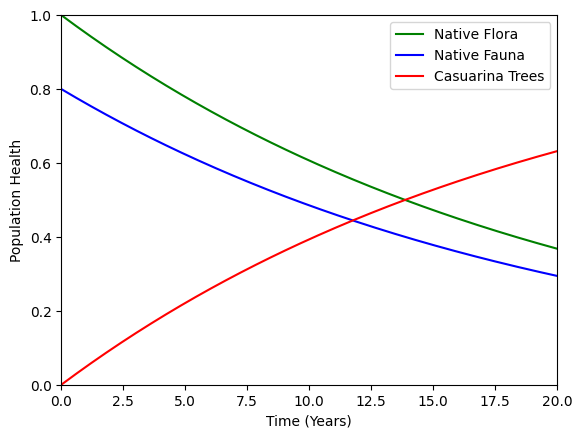

In [ ]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Parameters for the model
time_steps = np.linspace(0, 20, 200)  # 20 years, more points for smoother animation
casuarina_growth_rate = 0.05  # Growth rate of Casuarina trees per year
initial_native_population = 1.0  # Initial health of native flora and fauna (1.0 = healthy)

# Function to simulate the impact of Casuarina growth on native populations
def simulate_impact(time, growth_rate, initial_population):
    casuarina_population = 1 - np.exp(-growth_rate * time)
    native_population = initial_population * (1 - casuarina_population)
    return native_population, casuarina_population

# Setting up the plot
fig, ax = plt.subplots()
ax.set_xlim(0, 20)
ax.set_ylim(0, 1.0)
ax.set_xlabel('Time (Years)')
ax.set_ylabel('Population Health')
line_flora, = ax.plot([], [], label='Native Flora', color='green')
line_fauna, = ax.plot([], [], label='Native Fauna', color='blue')
line_casuarina, = ax.plot([], [], label='Casuarina Trees', color='red')
ax.legend()

# Initialization function for the animation
def init():
    line_flora.set_data([], [])
    line_fauna.set_data([], [])
    line_casuarina.set_data([], [])
    return line_flora, line_fauna, line_casuarina

# Update function for the animation
def update(frame):
    time = time_steps[frame]
    flora_health, casuarina_growth = simulate_impact(time, casuarina_growth_rate, initial_native_population)
    fauna_health = flora_health * 0.8  # Assuming fauna health is dependent on flora health

    line_flora.set_data(time_steps[:frame + 1], [simulate_impact(t, casuarina_growth_rate, initial_native_population)[0] for t in time_steps[:frame + 1]])
    line_fauna.set_data(time_steps[:frame + 1], [simulate_impact(t, casuarina_growth_rate, initial_native_population)[0] * 0.8 for t in time_steps[:frame + 1]])
    line_casuarina.set_data(time_steps[:frame + 1], [simulate_impact(t, casuarina_growth_rate, initial_native_population)[1] for t in time_steps[:frame + 1]])

    return line_flora, line_fauna, line_casuarina

# Creating the animation
ani = FuncAnimation(fig, update, frames=len(time_steps), init_func=init, blit=True, interval=50)

# To display the animation in Google Colab, we use HTML
from IPython.display import HTML
HTML(ani.to_html5_video())

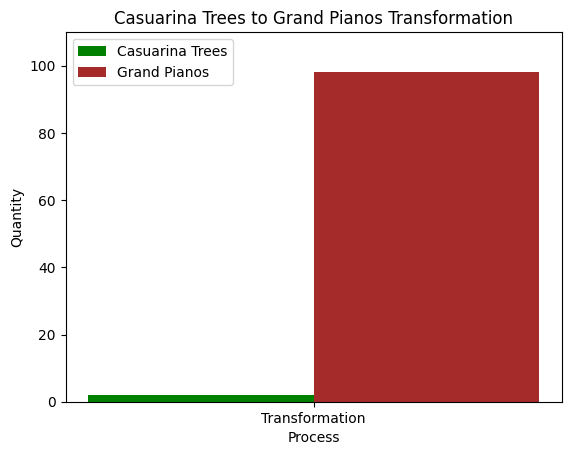

In [ ]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Parameters for the animation
frames = 50  # Total frames in the animation
trees = 100  # Initial number of Casuarina trees
pianos = 0   # Initial number of grand pianos

# Setting up the plot
fig, ax = plt.subplots()
ax.set_ylim(0, trees + 10)
bar_width = 0.4
index = np.arange(1)
bar_trees = ax.bar(index, trees, bar_width, label='Casuarina Trees', color='green')
bar_pianos = ax.bar(index + bar_width, pianos, bar_width, label='Grand Pianos', color='brown')

# Adding labels and title
ax.set_title('Casuarina Trees to Grand Pianos Transformation')
ax.set_xlabel('Process')
ax.set_ylabel('Quantity')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(['Transformation'])
ax.legend()

# Update function for the animation
def update(frame):
    # Calculating new values for each frame
    trees_remaining = max(trees - frame * 2, 0)
    pianos_made = min(frame * 2, trees)

    # Updating the bar heights
    bar_trees[0].set_height(trees_remaining)
    bar_pianos[0].set_height(pianos_made)

    # Return a tuple of the bars
    return (bar_trees[0], bar_pianos[0],)

# Creating the animation
ani = FuncAnimation(fig, update, frames=frames, blit=True, repeat=False)

# To display the animation in Google Colab, we use HTML
from IPython.display import HTML
HTML(ani.to_html5_video())